# <span style='color:pink'> Pakiety matematyczne - projekt  </span>

## <span style='color:pink'> Tydzień czwarty:  </span>
<span style='color:pink'> - Odszumianie </span>

In [54]:
using FFTW
using Plots
using WAV
using DSP

In [3]:
function denoising_high(sound, fs, N,cut_point) #wycina mniejsze wielkości
    tstep=1/fs
    time=LinRange(0, (N-1)/fs, N)
    freq_step = fs/N
    freq = LinRange(0, (N-1)*freq_step, N)
    
    fhat=fft(sound)
    PSD = real.(fhat .* conj(fhat)/N) #power spectral density
    
    indices=[i > cut_point for i in PSD]
    PSD_clean= indices .* PSD
    fhat_clean = indices .* fhat
    
    return time, PSD_clean, fhat_clean, freq
end

denoising_high (generic function with 1 method)

In [4]:
function denoising_low(sound, fs, N,cut_point) #wycina wieksze wielkości
    tstep=1/fs
    time=LinRange(0, (N-1)/fs, N) 
    freq_step = fs/N
    freq = LinRange(0, (N-1)/fs, N)
    
    fhat=fft(sound)
    PSD = real.(fhat .* conj(fhat)/N)
    
    indices=[i < cut_point for i in PSD]
    PSD_clean= indices .* PSD
    fhat_clean = indices .* fhat

    return time, PSD_clean, fhat_clean, freq
end

denoising_low (generic function with 1 method)

### Zaszumione 50Hz i 120Hz

In [143]:
fs = 2000
tstep = 1/fs
f0 = 120
N = floor(Int, 100 * fs/f0)
t = LinRange(0, (N-1)*tstep, N)

1666-element LinRange{Float64}:
 0.0,0.0005,0.001,0.0015,0.002,0.0025,…,0.83,0.8305,0.831,0.8315,0.832,0.8325

In [144]:
f = sin.(2π * 50t) + sin.(2π * 120t)
f_clean = f
f_noisy = f + 2.5 * randn(length(t));

In [145]:
fft_clean = fft(f_clean)
fft_noisy = fft(f_noisy);

In [146]:
PSD_clean = real.(fft_clean .* conj(fft_clean)/N)
PSD_noisy = real.(fft_noisy .* conj(fft_noisy)/N);

In [147]:
wavwrite(f_clean,"clean.wav")
wavwrite(f_noisy, "noisy.wav")

In [148]:
wavplay("clean.wav")
wavplay("noisy.wav")

In [149]:
time, PSD_filtered, fft_filtered, freq = denoising_high(f, fs, N, 100);

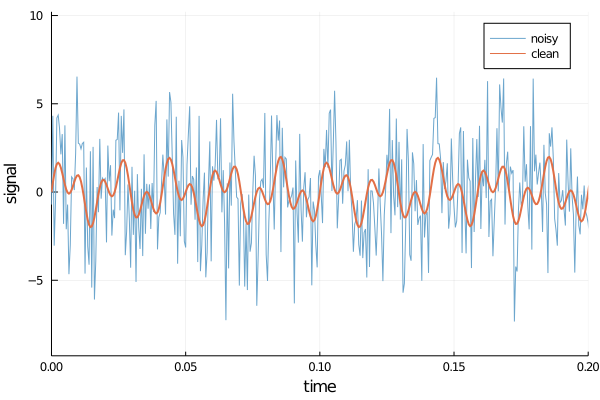

In [156]:
plot(time, f_noisy, label = "noisy", xlabel = "time",linecolor=:skyblue3, ylabel = "signal", x_lims = (0, 0.2))
plot!(time, f_clean, linewidth = 2, label = "clean")

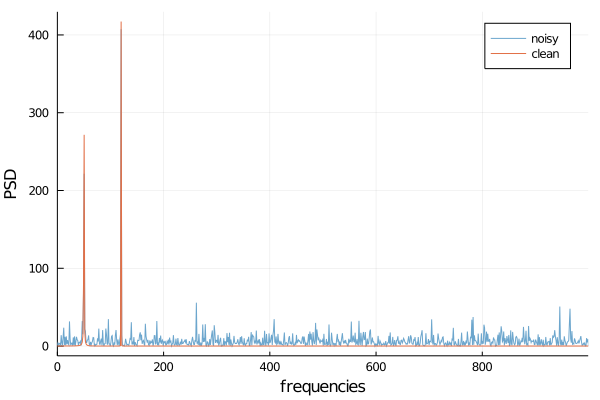

In [157]:
plot(freq, abs.(PSD_noisy), x_lims = (0, freq[end]/2), linecolor=:skyblue3, label = "noisy", xlabel = "frequencies", ylabel = "PSD")
plot!(freq, abs.(PSD_clean), label = "clean")

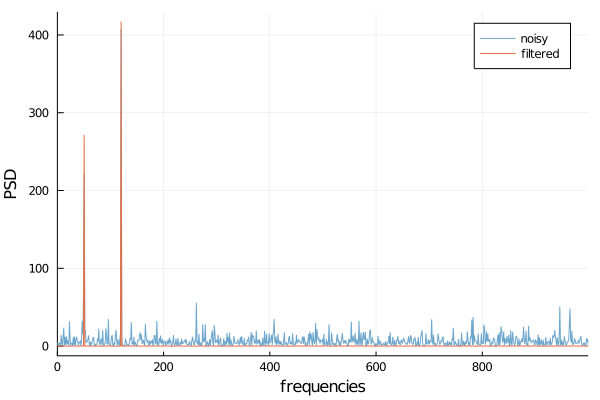

In [158]:
plot(freq, PSD_noisy, x_lims = (0, freq[end]/2), label = "noisy",linecolor=:skyblue3, xlabel = "frequencies", ylabel = "PSD")
plot!(freq, PSD_filtered, label = "filtered")

In [15]:
filtered = ifft(fft_filtered);

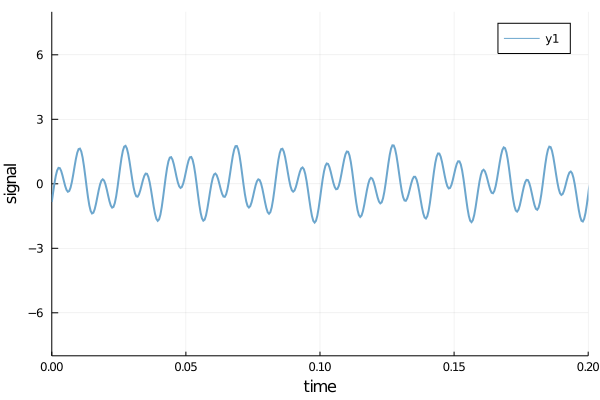

In [159]:
plot(time, real.(filtered), xlabel = "time",linecolor=:skyblue3, ylabel = "signal", x_lims = (0, 0.2), y_lims = (-8, 8), linewidth = 2)

In [17]:
wavwrite(real.(filtered), "filtered_50_120Hz")

In [32]:
wavplay("filtered_50_120Hz")

### Petrel śnieżny

In [82]:
wavplay("petrel_śnieżny.wav")

In [53]:
bird1, fs_bird = wavread("petrel_śnieżny.wav");

In [20]:
bird = bird1[:, 1];
N_bird = length(bird);

In [57]:
bird_win=bird .*Windows.hanning(N_bird);

In [58]:
fft_bird_win=fft(bird_win)
PSD_bird_win = real.(fft_bird_win .* conj(fft_bird_win)/N_bird);

In [84]:
time_bird, PSD_filtered_bird_win, fft_filtered_bird_win, freq_bird_win = denoising_low(bird_win, fs_bird, N_bird, 0.02);

In [165]:
plot(freq_bird, PSD_bird_win, linecolor=:steelblue1, x_lims = (0, freq_bird[end]/2), legend=false)

In [167]:
plot(freq_bird_win, PSD_filtered_bird_win,linecolor=:red1, x_lims = (0, freq_bird[end]/2), legend=false)

In [133]:
filtered_bird_win = ifft(fft_filtered_bird_win);

In [169]:
plot(time_bird, real.(filtered_bird_win),linecolor=:red1, label="filtered")
plot!(time_bird, real.(bird),linecolor=:steelblue1, label="not filtered")

In [131]:
wavplay("petrel_śnieżny.wav")

In [132]:
wavplay(real.(filtered_bird_win), fs_bird)

## Brzęczka

In [105]:
wavplay("brzęczka.wav")

In [121]:
brzeczka, fs_b = wavread("brzęczka.wav")[1][:, 1], wavread("brzęczka.wav")[2]
N=length(brzeczka)
brzeczka_win=brzeczka .*Windows.hanning(N);

In [114]:
fft_b=fft(brzeczka_win)
b_mag=abs.(fft_b)/N
fstep=fs_b/N
freq=LinRange(0,(N-1)*fstep,N)

freq_plot=freq[1:Int((N-1)/2+1)]
b_mag_plot=b_mag[1:Int((N-1)/2+1)];

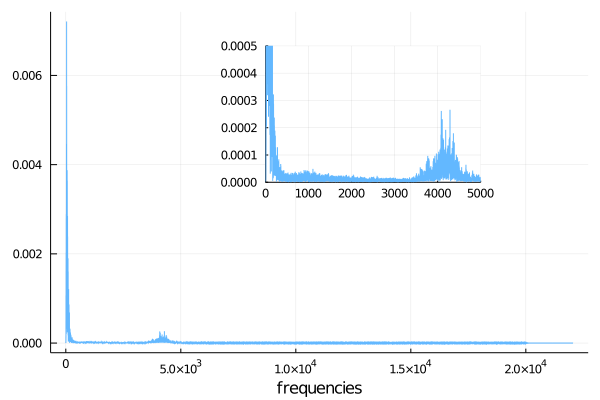

In [170]:
plot(freq_plot, b_mag_plot, xlabel="frequencies",linecolor=:steelblue1, legend=false)
plot!(freq_plot, b_mag_plot, xlims=(0,5e3),ylims=(0,0.0005),linecolor=:steelblue1, legend=false,
    inset=(1, bbox(0.4,0.1,0.4,0.4)), subplot=2)

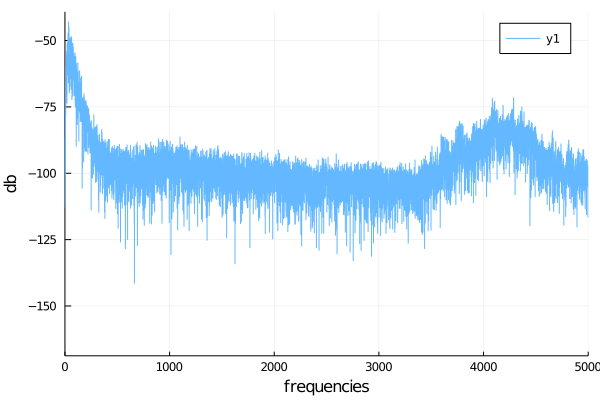

In [171]:
plot(freq_plot, 20*log10.(b_mag_plot),xlims=(0,5e3),linecolor=:steelblue1, xlabel="frequencies", ylabel="db")

In [117]:
time,PSD_brz,clear_brzeczka,freq=denoising_high(brzeczka,fs_b,N, 0.0005);

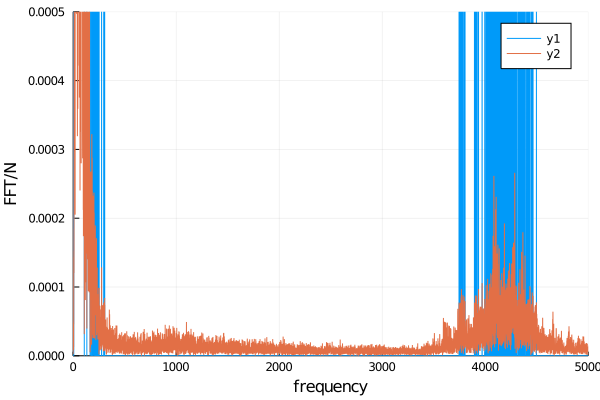

In [119]:
L=[i for i in 1:Int((N-1)/2)]
plot(freq[L], PSD_brz[L], xlabel = "frequency", ylabel = "FFT/N", ylims=(0,0.0005),xlims=(0,5e3))
plot!(freq_plot, b_mag_plot, xlims=(0,5e3),ylims=(0,0.0005))

In [128]:
brzeczka_c=ifft(clear_brzeczka)
wavplay(abs.(brzeczka_c),fs_b)